In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
test=pd.read_csv('test.csv')
train=pd.read_csv('train.csv')
sample=pd.read_csv('sample_submission.csv')

In [5]:
import cv2
import os

In [6]:
image_folder = '/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images'

image_files = [f for f in os.listdir(image_folder) if os.path.isfile(os.path.join(image_folder, f))]

def display_image(image_path):

    image = cv2.imread(image_path)

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.imshow(image_rgb)
    plt.title(os.path.basename(image_path))
    plt.axis('off')
    plt.show()

In [7]:
for image_file in image_files:
    image_path = os.path.join(image_folder, image_file)
    print(image_path)

/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Test_588.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Train_1088.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Train_364.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Test_1270.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Train_1705.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Train_1063.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Test_1516.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Train_402.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Train_416.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Train_1077.jpg
/Users/mohantandon/Desktop/CSI MAIN/plant-pathology-2020-fgvc7 (1)/images/Test_1502.jpg
/Users/mohantandon/Desktop/CS

In [8]:
test.head()

,image_id
0,Test_0
1,Test_1
2,Test_2
3,Test_3
4,Test_4


In [9]:
train.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0


In [10]:
sample.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Test_0,0.25,0.25,0.25,0.25
1,Test_1,0.25,0.25,0.25,0.25
2,Test_2,0.25,0.25,0.25,0.25
3,Test_3,0.25,0.25,0.25,0.25
4,Test_4,0.25,0.25,0.25,0.25


In [11]:
from tqdm import tqdm
IMAGE_PATH = image_folder + "/"

def load_image(image_id):
    file_path = image_id + ".jpg"
    image = cv2.imread(IMAGE_PATH + file_path)
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

tqdm.pandas()

SAMPLE_LEN = len(train)
train_images = train["image_id"][:SAMPLE_LEN].progress_apply(load_image)

100%|███████████████████████████████████████| 1821/1821 [00:41<00:00, 44.31it/s]


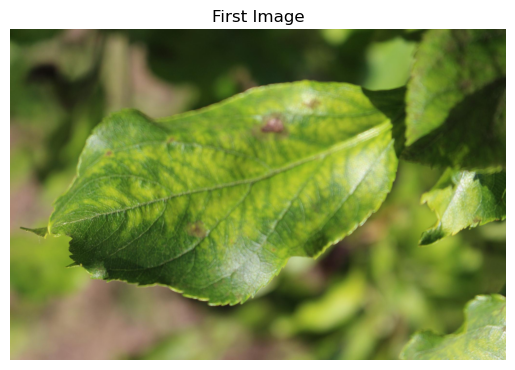

In [12]:
plt.imshow(train_images.iloc[0])
plt.title("First Image")
plt.axis('off')
plt.show()

In [13]:
(len(train), len(test))

(1821, 1821)

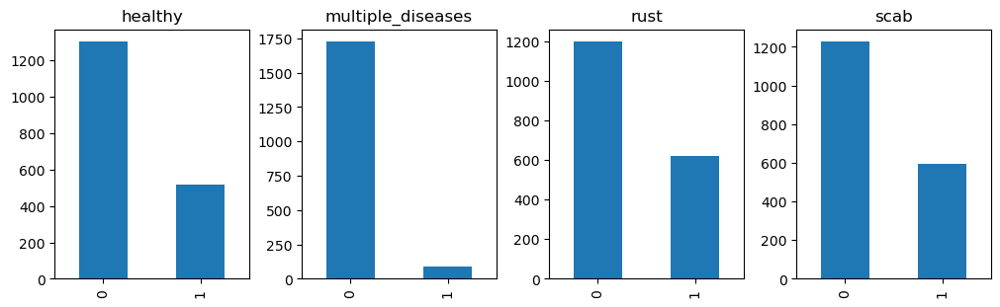

In [14]:
LABEL_COLS = ['healthy', 'multiple_diseases', 'rust', 'scab']
_, axes = plt.subplots(ncols=4, nrows=1, constrained_layout=True, figsize=(10, 3))
for ax, column in zip(axes, LABEL_COLS):
    train[column].value_counts().plot.bar(title=column, ax=ax)
plt.show()

<AxesSubplot:title={'center':'Label dist'}>

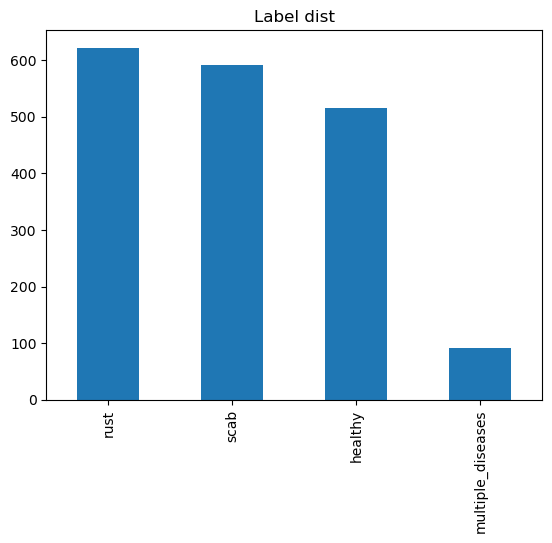

In [15]:
plt.title('Label dist')
train[LABEL_COLS].idxmax(axis=1).value_counts().plot.bar()

In [16]:
from PIL import Image
from collections import Counter
def get_size(df):
    hs, ws = [], []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        img = Image.open(os.path.join(IMAGE_PATH, row.image_id + '.jpg'))
        h, w = img.size
        hs.append(h)
        ws.append(w)
    return hs, ws

In [17]:
train_heights, train_widths = get_size(train)
test_heights, test_widths = get_size(test)

100%|█████████████████████████████████████| 1821/1821 [00:00<00:00, 2868.24it/s]


train height value counts: Counter({2048: 1819, 1365: 2})
train width value counts: Counter({1365: 1819, 2048: 2})
test height value counts: Counter({2048: 1801, 1365: 20})
test width value counts: Counter({1365: 1801, 2048: 20})


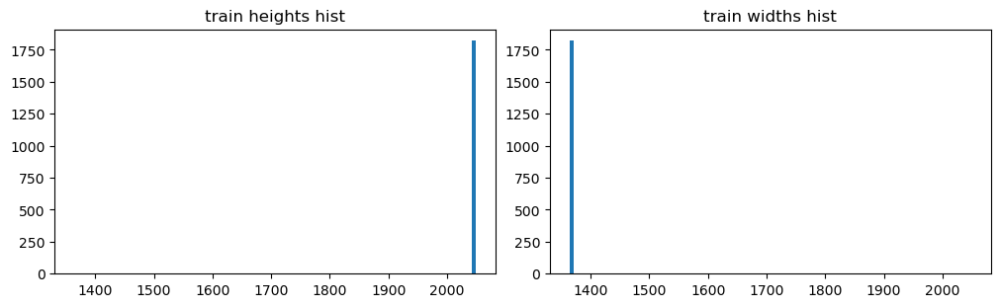

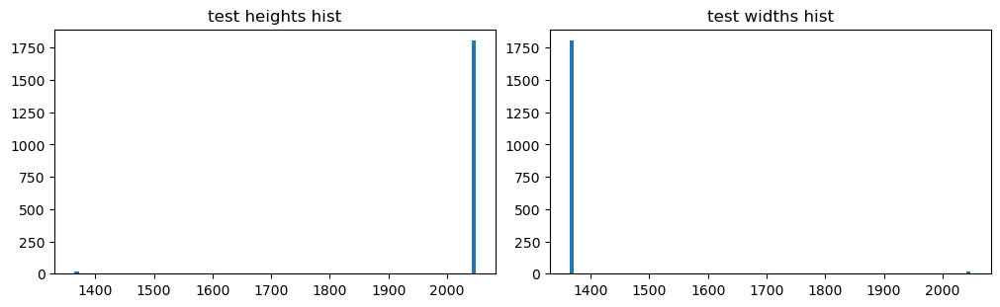

In [18]:
from collections import Counter
for set_label, set_size in ('train', [train_heights, train_widths]), ('test', [test_heights, test_widths]):
    print(f'{set_label} height value counts: {Counter(set_size[0])}')
    print(f'{set_label} width value counts: {Counter(set_size[1])}')

    _, axes = plt.subplots(ncols=2, nrows=1, constrained_layout=True, figsize=(10, 3))
    for ax, column, vals in zip(axes, ['heights', 'widths'], set_size):
        ax.hist(vals, bins=100)
        ax.set_title(f'{set_label} {column} hist')

plt.show()

The images are either: 2048x1365 or 1365x2048.

In [19]:
def plot_colour_hist(df, title):
    red_values = []; green_values = []; blue_values = []; all_channels = []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        img = np.array(Image.open(os.path.join(IMAGE_PATH, row.image_id + '.jpg')))
        red_values.append(np.mean(img[:, :, 0]))
        green_values.append(np.mean(img[:, :, 1]))
        blue_values.append(np.mean(img[:, :, 2]))
        all_channels.append(np.mean(img))
        
    _, axes = plt.subplots(ncols=4, nrows=1, constrained_layout=True, figsize=(16, 3), sharey=True)
    for ax, column, vals, c in zip(
        axes,
        ['red', 'green', 'blue', 'all colours'],
        [red_values, green_values, blue_values, all_channels],
        'rgbk'
    ):
        ax.hist(vals, bins=100, color=c)
        ax.set_title(f'{column} hist')

    plt.suptitle(title)
    plt.show()

100%|███████████████████████████████████████| 1821/1821 [01:31<00:00, 19.96it/s]


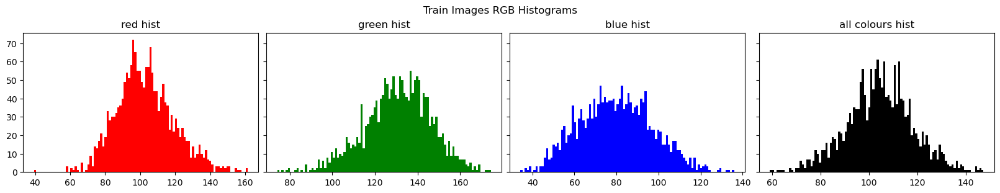

In [20]:
plot_colour_hist(train, 'Train Images RGB Histograms')

100%|███████████████████████████████████████| 1821/1821 [01:30<00:00, 20.14it/s]


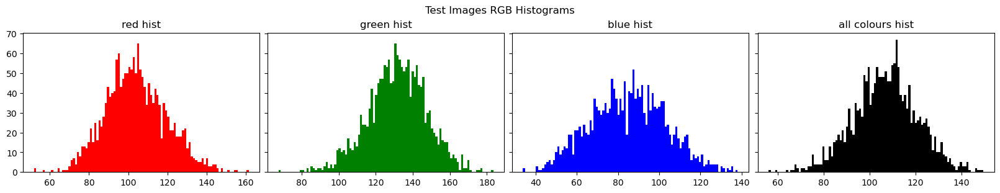

In [21]:
plot_colour_hist(test, 'Test Images RGB Histograms')

In [22]:
def visualize_leaves(cond=[0, 0, 0, 0], cond_cols=["healthy"], is_cond=True):
    if not is_cond:
        cols, rows = 3, min([3, len(train_images)//3])
        fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
        for col in range(cols):
            for row in range(rows):
                ax[row, col].imshow(train_images.iloc[-row*3-col-1])
        return None
        
    cond_0 = "healthy == {}".format(cond[0])
    cond_1 = "scab == {}".format(cond[1])
    cond_2 = "rust == {}".format(cond[2])
    cond_3 = "multiple_diseases == {}".format(cond[3])
    
    cond_list = []
    for col in cond_cols:
        if col == "healthy":
            cond_list.append(cond_0)
        if col == "scab":
            cond_list.append(cond_1)
        if col == "rust":
            cond_list.append(cond_2)
        if col == "multiple_diseases":
            cond_list.append(cond_3)
    
    data = train.loc[:100]
    for cond in cond_list:
        data = data.query(cond)
        
    images = train_images.loc[list(data.index)]
    cols, rows = 3, min([3, len(images)//3])
    
    fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
    for col in range(cols):
        for row in range(rows):
            ax[row, col].imshow(images.iloc[row*3+col])
    plt.show()

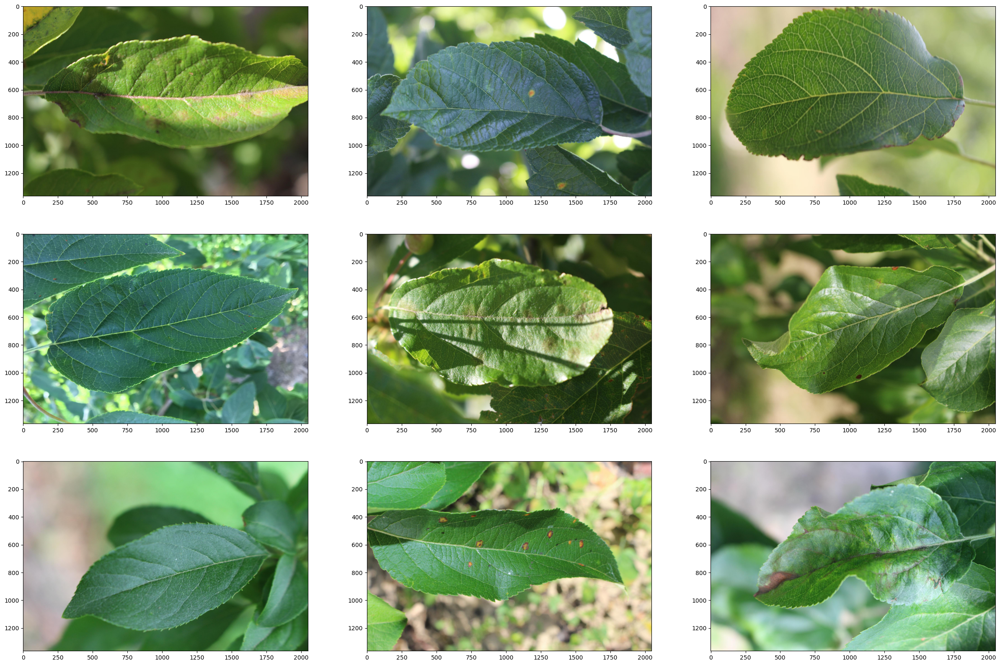

In [23]:
visualize_leaves(is_cond=False)

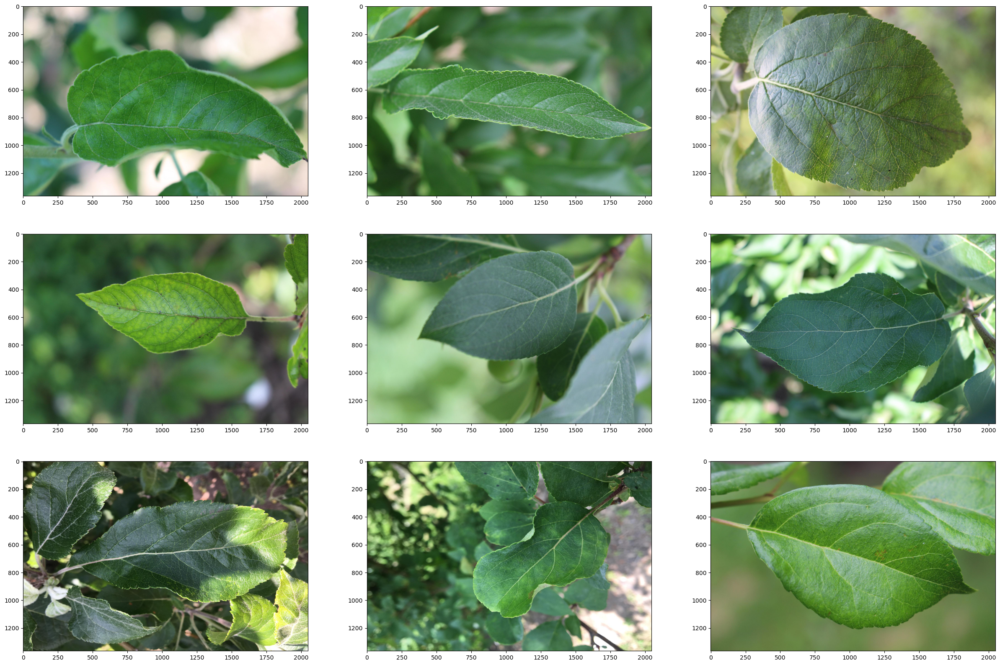

In [24]:
visualize_leaves(cond=[1, 0, 0, 0], cond_cols=["healthy"])

These are the healthy leaves

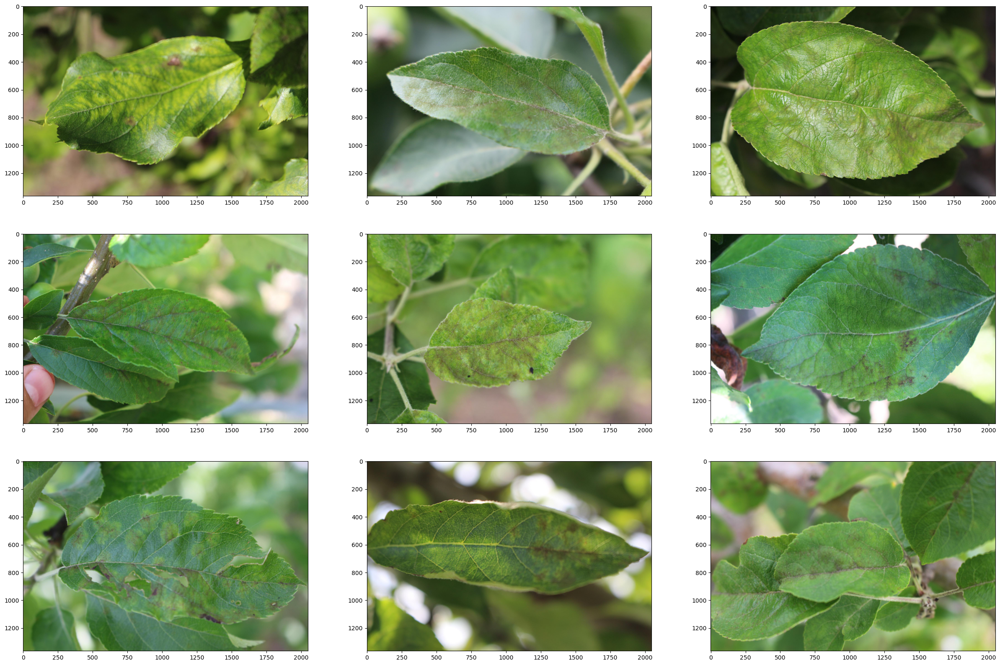

In [25]:
visualize_leaves(cond=[0, 1, 0, 0], cond_cols=["scab"])

Leaves with Scab

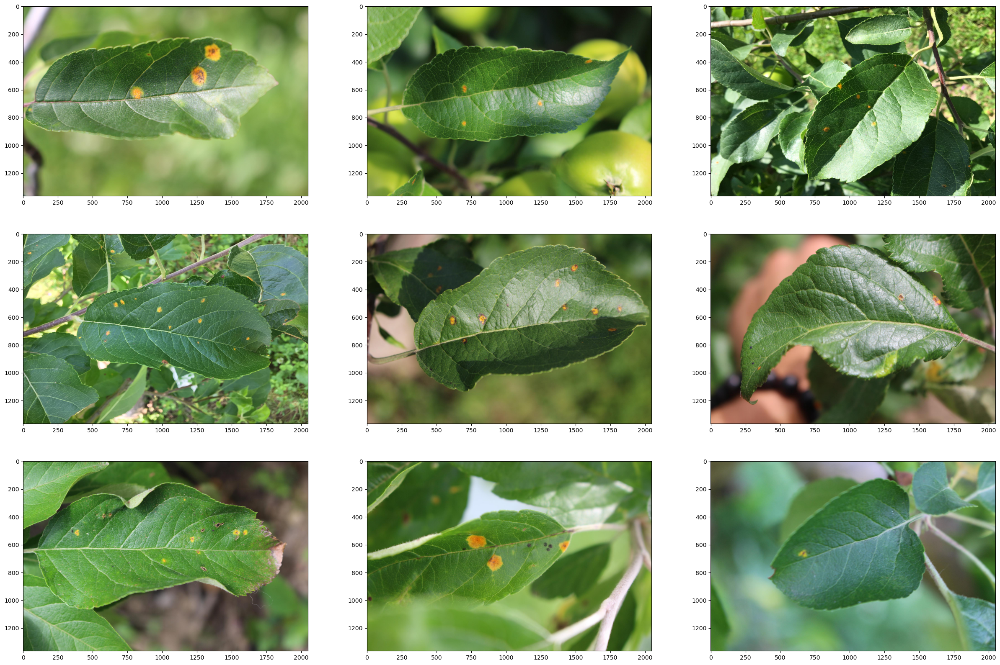

In [26]:
visualize_leaves(cond=[0, 0, 1, 0], cond_cols=["rust"])

Leaves with rust

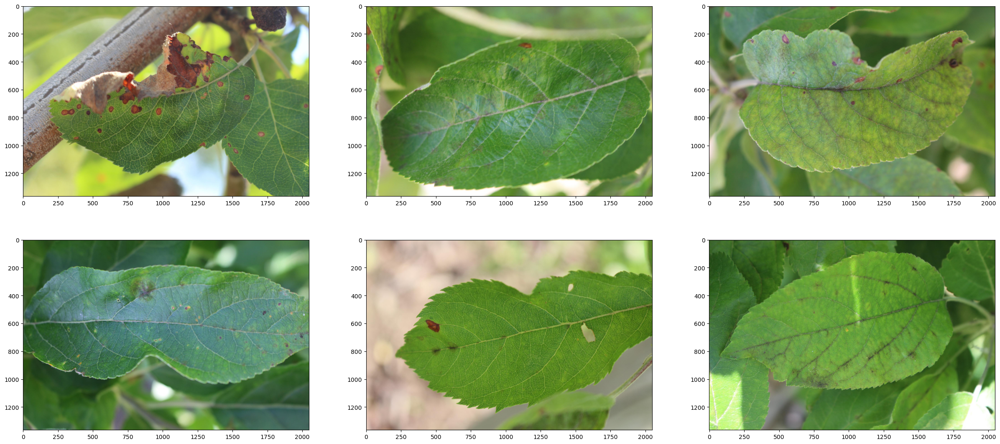

In [27]:
visualize_leaves(cond=[0, 0, 0, 1], cond_cols=["multiple_diseases"])

Leaves with multiple diseases

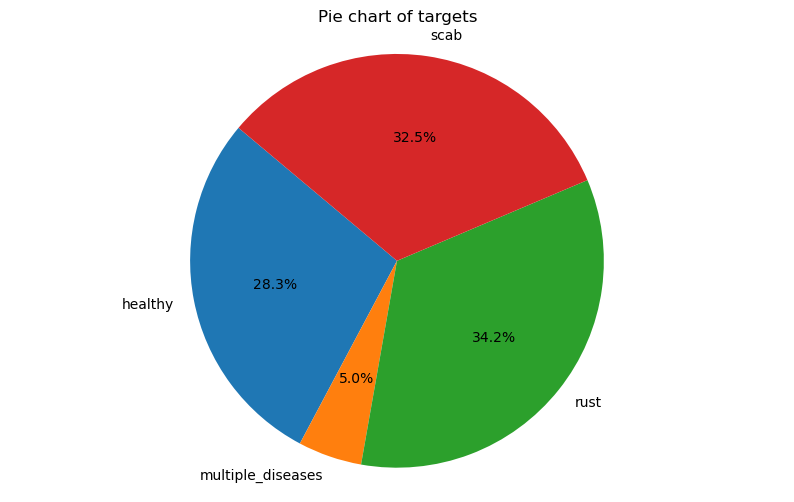

In [28]:
label_counts = train.iloc[:, 1:].sum()
plt.figure(figsize=(10, 6))
plt.pie(label_counts, labels=label_counts.index, autopct='%1.1f%%', startangle=140)
plt.title("Pie chart of targets")
plt.axis('equal')
plt.show()

In [29]:
def extract_color_histogram(image, bins=(8, 8, 8)):
    hist = cv2.calcHist([image], [0, 1, 2], None, bins, [0, 256, 0, 256, 0, 256])
    hist = cv2.normalize(hist, hist).flatten()
    return hist

In [30]:
def extract_features(df, image_folder):
    features = []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        image_path = os.path.join(image_folder, row.image_id + '.jpg')
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        hist = extract_color_histogram(image)
        features.append(hist)
    return np.array(features)

In [31]:
train_features = extract_features(train, image_folder)
test_features = extract_features(test, image_folder)

100%|███████████████████████████████████████| 1821/1821 [00:50<00:00, 36.37it/s]


In [32]:
LABEL_COLS = ['healthy', 'multiple_diseases', 'rust', 'scab']
train['label'] = train[LABEL_COLS].idxmax(axis=1)

In [33]:
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import classification_report, accuracy_score
lb = LabelBinarizer()
train_labels = lb.fit_transform(train['label'])

In [34]:
X_train, X_val, y_train, y_val = train_test_split(train_features, train_labels, test_size=0.33, random_state=101)

In [35]:
y_train = y_train.argmax(axis=1)
y_val = y_val.argmax(axis=1)

In [36]:
svm_model = SVC(kernel='linear', probability=True)
svm_model.fit(X_train, y_train)

SVC(kernel='linear', probability=True)

In [37]:
val_preds = svm_model.predict(X_val)

In [38]:
accuracy = accuracy_score(y_val, val_preds)
print(f"Validation Accuracy: {accuracy}")

Validation Accuracy: 0.5108153078202995


In [39]:
print(classification_report(y_val, val_preds, target_names=lb.classes_))

                   precision    recall  f1-score   support

          healthy       0.55      0.46      0.50       181
multiple_diseases       0.00      0.00      0.00        29
             rust       0.54      0.47      0.50       212
             scab       0.47      0.69      0.56       179

         accuracy                           0.51       601
        macro avg       0.39      0.41      0.39       601
     weighted avg       0.50      0.51      0.49       601



/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [40]:
test_preds = svm_model.predict(test_features)

In [41]:
test_labels = lb.classes_[test_preds]

In [42]:
svm_model = SVC(kernel='rbf', probability=True)
svm_model.fit(X_train, y_train)

SVC(probability=True)

In [43]:
val_preds = svm_model.predict(X_val)

In [44]:
accuracy = accuracy_score(y_val, val_preds)
print(f"Validation Accuracy: {accuracy}")

Validation Accuracy: 0.5557404326123128


In [45]:
print(classification_report(y_val, val_preds, target_names=lb.classes_))

                   precision    recall  f1-score   support

          healthy       0.60      0.53      0.56       181
multiple_diseases       0.00      0.00      0.00        29
             rust       0.56      0.55      0.56       212
             scab       0.52      0.68      0.59       179

         accuracy                           0.56       601
        macro avg       0.42      0.44      0.43       601
     weighted avg       0.53      0.56      0.54       601



/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [46]:
svm_model = SVC(kernel='poly', probability=True)
svm_model.fit(X_train, y_train)

SVC(kernel='poly', probability=True)

In [47]:
val_preds = svm_model.predict(X_val)

In [48]:
accuracy = accuracy_score(y_val, val_preds)
print(f"Validation Accuracy: {accuracy}")

Validation Accuracy: 0.562396006655574


In [49]:
print(classification_report(y_val, val_preds, target_names=lb.classes_))

                   precision    recall  f1-score   support

          healthy       0.62      0.53      0.57       181
multiple_diseases       0.00      0.00      0.00        29
             rust       0.57      0.58      0.57       212
             scab       0.52      0.67      0.58       179

         accuracy                           0.56       601
        macro avg       0.43      0.44      0.43       601
     weighted avg       0.54      0.56      0.55       601



/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/mohantandon/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


It is thus noticed that SVM performs the best when the polynomial kernel is used

In [50]:
test_preds = svm_model.predict(test_features)
test_labels = lb.classes_[test_preds]

In [51]:
submission = pd.DataFrame({'image_id': test['image_id'], 'label': test_labels})
submission.to_csv('submission.csv', index=False)

In the provided SVM model, we used color histograms as the handcrafted features extracted from the images, rather than directly using the raw pixel values. Using color histograms is a common technique in traditional machine learning for image classification as it captures the distribution of colors in an image, which can be a useful feature for distinguishing between different classes.



In [52]:
from sklearn.preprocessing import StandardScaler
def extract_raw_pixels(image, size=(64, 64)):
    resized_image = cv2.resize(image, size)
    return resized_image.flatten()

def extract_features(df, image_folder, size=(64, 64)):
    features = []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        image_path = os.path.join(image_folder, row.image_id + '.jpg')
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        pixels = extract_raw_pixels(image, size)
        features.append(pixels)
    return np.array(features)

train_features = extract_features(train, image_folder)
test_features = extract_features(test, image_folder)

100%|███████████████████████████████████████| 1821/1821 [00:35<00:00, 51.21it/s]


In [53]:
subset_size = 1000  # Choose a suitable size
subset_indices = np.random.choice(train_features.shape[0], subset_size, replace=False)
subset_features = train_features[subset_indices]

In [54]:
scaler = StandardScaler()
scaler.fit(subset_features)

StandardScaler()

In [55]:
train_features = scaler.transform(train_features)
test_features = scaler.transform(test_features)

In [56]:
LABEL_COLS = ['healthy', 'multiple_diseases', 'rust', 'scab']
train['label'] = train[LABEL_COLS].idxmax(axis=1)

In [57]:
lb = LabelBinarizer()
train_labels = lb.fit_transform(train['label'])

In [59]:
X_train, X_val, y_train, y_val = train_test_split(train_features, train_labels, test_size=0.33, random_state=101)
y_train = y_train.argmax(axis=1)
y_val = y_val.argmax(axis=1)
svm_model = SVC(kernel='linear', probability=True)
svm_model.fit(X_train, y_train)
val_preds = svm_model.predict(X_val)

In [60]:
accuracy = accuracy_score(y_val, val_preds)
print(f"Validation Accuracy: {accuracy}")

Validation Accuracy: 0.39600665557404324


In [61]:
print(classification_report(y_val, val_preds, target_names=lb.classes_))
test_preds = svm_model.predict(test_features)
test_labels = lb.classes_[test_preds]

                   precision    recall  f1-score   support

          healthy       0.39      0.43      0.41       181
multiple_diseases       0.06      0.03      0.04        29
             rust       0.45      0.35      0.39       212
             scab       0.38      0.47      0.43       179

         accuracy                           0.40       601
        macro avg       0.32      0.32      0.32       601
     weighted avg       0.39      0.40      0.39       601



After using only pixels instead of averaging things out we see the accuracy dropping

In [62]:
X_train, X_val, y_train, y_val = train_test_split(train_features, train_labels, test_size=0.33, random_state=101)
y_train = y_train.argmax(axis=1)
y_val = y_val.argmax(axis=1)

In [63]:
svm_model = SVC(kernel='poly', probability=True)
svm_model.fit(X_train, y_train)
val_preds = svm_model.predict(X_val)

In [64]:
accuracy = accuracy_score(y_val, val_preds)
print(f"Validation Accuracy: {accuracy}")

Validation Accuracy: 0.3544093178036606


On using raw pixel data we see the accuracy dropping way too much

In [68]:
from sklearn.ensemble import RandomForestClassifier
def extract_color_histogram(image, bins=(8, 8, 8)):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    hist = cv2.calcHist([hsv], [0, 1, 2], None, bins, [0, 180, 0, 256, 0, 256])
    cv2.normalize(hist, hist)
    return hist.flatten()

def extract_features(df, image_folder):
    features = []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        image_path = os.path.join(image_folder, row.image_id + '.jpg')
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        hist = extract_color_histogram(image)
        features.append(hist)
    return np.array(features)

train_features = extract_features(train, image_folder)
test_features = extract_features(test, image_folder)

100%|███████████████████████████████████████| 1821/1821 [00:52<00:00, 34.69it/s]


In [69]:
scaler = StandardScaler()
train_features = scaler.fit_transform(train_features)
test_features = scaler.transform(test_features)

In [70]:
LABEL_COLS = ['healthy', 'multiple_diseases', 'rust', 'scab']
train['label'] = train[LABEL_COLS].idxmax(axis=1)

In [71]:
lb = LabelBinarizer()
train_labels = lb.fit_transform(train['label'])

In [72]:
X_train, X_val, y_train, y_val = train_test_split(train_features, train_labels, test_size=0.33, random_state=101)

In [73]:
y_train = y_train.argmax(axis=1)
y_val = y_val.argmax(axis=1)
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [74]:
val_preds = rf_model.predict(X_val)
accuracy = accuracy_score(y_val, val_preds)
print(f"Validation Accuracy: {accuracy}")
print(classification_report(y_val, val_preds, target_names=lb.classes_))

Validation Accuracy: 0.800332778702163
                   precision    recall  f1-score   support

          healthy       0.79      0.76      0.77       181
multiple_diseases       0.00      0.00      0.00        29
             rust       0.89      0.94      0.92       212
             scab       0.72      0.80      0.76       179

         accuracy                           0.80       601
        macro avg       0.60      0.63      0.61       601
     weighted avg       0.76      0.80      0.78       601



We see that Random Forest Classifier provides a much better result than Support Vector Machines, using the we used color histograms as the handcrafted features extracted from the images.

Text(0, 0.5, 'Error Rate')

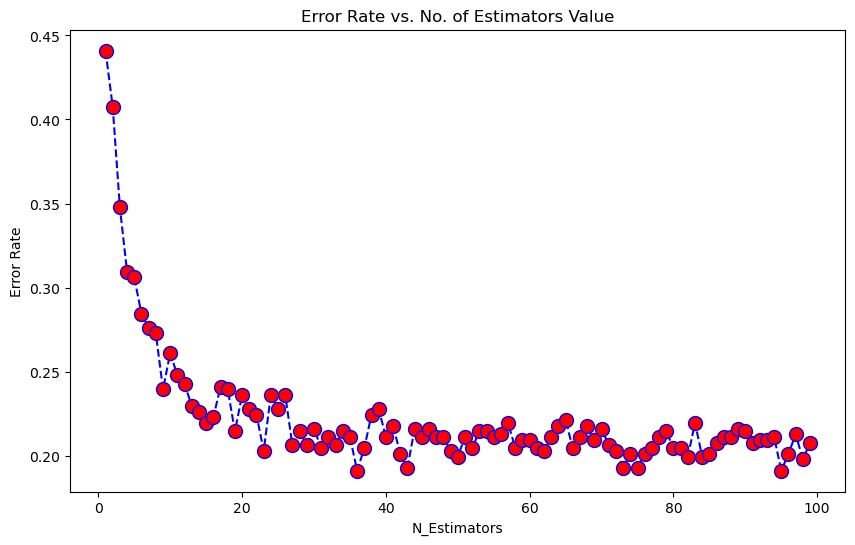

In [76]:
error_rate=[]
for i in range (1,100):
    rfc=RandomForestClassifier(n_estimators=i)
    rfc.fit(X_train,y_train)
    pred_i=rfc.predict(X_val)
    error_rate.append(np.mean(pred_i!=y_val))
plt.figure(figsize= (10,6))
plt.plot(range(1,100), error_rate, color='blue', linestyle='dashed', marker='o',markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. No. of Estimators Value')
plt.xlabel('N_Estimators')
plt.ylabel('Error Rate')

In [84]:
test_preds = rf_model.predict(test_features)
test_labels = lb.classes_[test_preds]

In [85]:
submission = pd.DataFrame({'image_id': test['image_id'], 'label': test_labels})
submission.to_csv('submissionrfc.csv', index=False)

In [86]:
from sklearn.ensemble import GradientBoostingClassifier

In [87]:
def extract_color_histogram(image, bins=(8, 8, 8)):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    hist = cv2.calcHist([hsv], [0, 1, 2], None, bins, [0, 180, 0, 256, 0, 256])
    cv2.normalize(hist, hist)
    return hist.flatten()

def extract_features(df, image_folder):
    features = []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        image_path = os.path.join(image_folder, row.image_id + '.jpg')
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        hist = extract_color_histogram(image)
        features.append(hist)
    return np.array(features)

train_features = extract_features(train, image_folder)
test_features = extract_features(test, image_folder)

100%|███████████████████████████████████████| 1821/1821 [00:52<00:00, 34.83it/s]


In [88]:
scaler = StandardScaler()
train_features = scaler.fit_transform(train_features)
test_features = scaler.transform(test_features)

In [89]:
LABEL_COLS = ['healthy', 'multiple_diseases', 'rust', 'scab']
train['label'] = train[LABEL_COLS].idxmax(axis=1)
lb = LabelBinarizer()
train_labels = lb.fit_transform(train['label'])
X_train, X_val, y_train, y_val = train_test_split(train_features, train_labels, test_size=0.33, random_state=101)

In [116]:
y_train = y_train
y_val = y_val
gbm_model = GradientBoostingClassifier(n_estimators=400, random_state=42)
gbm_model.fit(X_train, y_train)

GradientBoostingClassifier(n_estimators=400, random_state=42)

In [117]:
val_preds = gbm_model.predict(X_val)

In [118]:
accuracy = accuracy_score(y_val, val_preds)
print(f"Validation Accuracy: {accuracy}")
print(classification_report(y_val, val_preds, target_names=lb.classes_))

Validation Accuracy: 0.7920133111480865
                   precision    recall  f1-score   support

          healthy       0.76      0.73      0.75       181
multiple_diseases       0.56      0.17      0.26        29
             rust       0.93      0.92      0.92       212
             scab       0.69      0.80      0.74       179

         accuracy                           0.79       601
        macro avg       0.73      0.66      0.67       601
     weighted avg       0.79      0.79      0.78       601



We see slight imporovements in overall accuracy as we increase n_estimators in Gradient Boosting Machine. The results through this are also good.

In [119]:
test_preds = gbm_model.predict(test_features)
test_labels = lb.classes_[test_preds]
submission = pd.DataFrame({'image_id': test['image_id'], 'label': test_labels})
submission.to_csv('submissiongbm.csv', index=False)